**Modelo InceptionV3 - Version 2**


In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
!df -h

Filesystem      Size  Used Avail Use% Mounted on
overlay         167G   40G  127G  24% /
tmpfs            64M     0   64M   0% /dev
shm              13G     0   13G   0% /dev/shm
/dev/root       2.0G  1.2G  817M  59% /sbin/docker-init
tmpfs            13G   40K   13G   1% /var/colab
/dev/sda1       174G   43G  131G  25% /opt/bin/.nvidia
tmpfs            13G     0   13G   0% /proc/acpi
tmpfs            13G     0   13G   0% /proc/scsi
tmpfs            13G     0   13G   0% /sys/firmware
drive            15G   13G  2.3G  86% /content/gdrive


In [ ]:
!free -h

              total        used        free      shared  buff/cache   available
Mem:            25G        1.0G         22G        1.2M        2.1G         24G
Swap:            0B          0B          0B


In [ ]:
!ls -ltr /content/gdrive/MyDrive/tfm/version2/train_dir

total 152
drwx------ 2 root root 4096 Feb  8 22:30  Apple___Apple_scab
drwx------ 2 root root 4096 Feb  8 22:30  Apple___Black_rot
drwx------ 2 root root 4096 Feb  8 22:30  Apple___Cedar_apple_rust
drwx------ 2 root root 4096 Feb  8 22:30  Apple___healthy
drwx------ 2 root root 4096 Feb  8 22:31  Blueberry___healthy
drwx------ 2 root root 4096 Feb  8 22:31  Cherry___healthy
drwx------ 2 root root 4096 Feb  8 22:31  Cherry___Powdery_mildew
drwx------ 2 root root 4096 Feb  8 22:31 'Corn___Cercospora_leaf_spot Gray_leaf_spot'
drwx------ 2 root root 4096 Feb  8 22:32  Corn___Common_rust
drwx------ 2 root root 4096 Feb  8 22:32  Corn___healthy
drwx------ 2 root root 4096 Feb  8 22:32  Corn___Northern_Leaf_Blight
drwx------ 2 root root 4096 Feb  8 22:32  Grape___Black_rot
drwx------ 2 root root 4096 Feb  8 22:32 'Grape___Esca_(Black_Measles)'
drwx------ 2 root root 4096 Feb  8 22:32  Grape___healthy
drwx------ 2 root root 4096 Feb  8 22:32 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)'
drwx---

In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Tue Mar 22 09:45:06 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   36C    P8     9W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
!nvidia-smi -q -i 0 | grep "Product Name"

    Product Name                          : Tesla T4


In [ ]:
from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('To enable a high-RAM runtime, select the Runtime > "Change runtime type"')
  print('menu, and then select High-RAM in the Runtime shape dropdown. Then, ')
  print('re-execute this cell.')
else:
  print('You are using a high-RAM runtime!')

Your runtime has 27.3 gigabytes of available RAM

You are using a high-RAM runtime!


In [ ]:
# Import libraries

# Librerias comunes
import pandas as pd
import numpy as np
import os, math, random
from datetime import datetime as dt
import datetime

# Librerias keras y tensorflow

from tensorflow import keras
import tensorflow as tf
from keras.layers import Dense,GlobalAveragePooling2D,BatchNormalization,Dropout
from keras.preprocessing import image
from keras.preprocessing.image import ImageDataGenerator
from keras import preprocessing
from keras.models import Model
from tensorflow.keras.optimizers import Adam
from keras.models import load_model

from tensorflow.keras import optimizers
from tensorflow.keras.optimizers import schedules

# Librerias de Inception V3
from keras.applications.inception_v3 import preprocess_input
from keras.applications import inception_v3

# Librerias para visualizar las imágenes
%matplotlib inline
import matplotlib.pyplot as plt
from PIL import Image

# Librerias de sklearn
#from sklearn.metrics import confusion_matrix
#%load_ext tensorboard

seed = 1234

In [ ]:
print(f'Versión de tensorflow: {tf.__version__}')

Versión de tensorflow: 2.8.0


In [ ]:
from tensorflow.python.client import device_lib
device_lib.list_local_devices()

[name: "/device:CPU:0"
 device_type: "CPU"
 memory_limit: 268435456
 locality {
 }
 incarnation: 13688195243516282438
 xla_global_id: -1, name: "/device:GPU:0"
 device_type: "GPU"
 memory_limit: 14465892352
 locality {
   bus_id: 1
   links {
   }
 }
 incarnation: 14246037599651800975
 physical_device_desc: "device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5"
 xla_global_id: 416903419]

In [ ]:
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))

Num GPUs Available:  1


In [ ]:
# Inicialización de directorios

# inicializo el contenido del directorio de logs
# !rm -rf log_dir
# instrucciones para visualizar con Tensor Board
# log_dir = '/content/gdrive/MyDrive/tfm/logs/' + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")

#train_dir = '/content/gdrive/MyDrive/tfm/small-dataset/train_dir/'
#test_dir = '/content/gdrive/MyDrive/tfm/small-dataset/test_dir/'
#val_dir = '/content/gdrive/MyDrive/tfm/small-dataset/val_dir/'

model_saved_dir = '/content/gdrive/MyDrive/tfm/models/inceptionV3-2/v2-01-InceptionV3-2-model'

train_dir = '/content/gdrive/MyDrive/tfm/version2/train_dir/'
test_dir = '/content/gdrive/MyDrive/tfm/version2/test_dir/'
val_dir = '/content/gdrive/MyDrive/tfm/version2/val_dir/'

In [ ]:
# Función para visualizar una imagen

def get_subplot_grid(mylist, columns, figwidth, figheight):
    plot_rows = math.ceil(len(mylist) / columns)
    fig, ax = plt.subplots(plot_rows, columns, sharey=True, sharex=False)
    fig.set_figwidth(figwidth)
    fig.set_figheight(figheight)
    fig.subplots_adjust(hspace=0.1)
    axflat = ax.flat
    #remove the unused subplot, if any
    for ax in axflat[ax.size - 1:len(mylist) - 1:-1]:
        ax.set_visible(False)

    return fig, axflat

In [ ]:
# tamaño de las imagenes: InceptionV3 necesita las dimensiones (299x299x3)
im_width = 299
im_height = 299
channels=3

In [ ]:
sub_class = os.listdir(train_dir)
n_classes = len(sub_class)

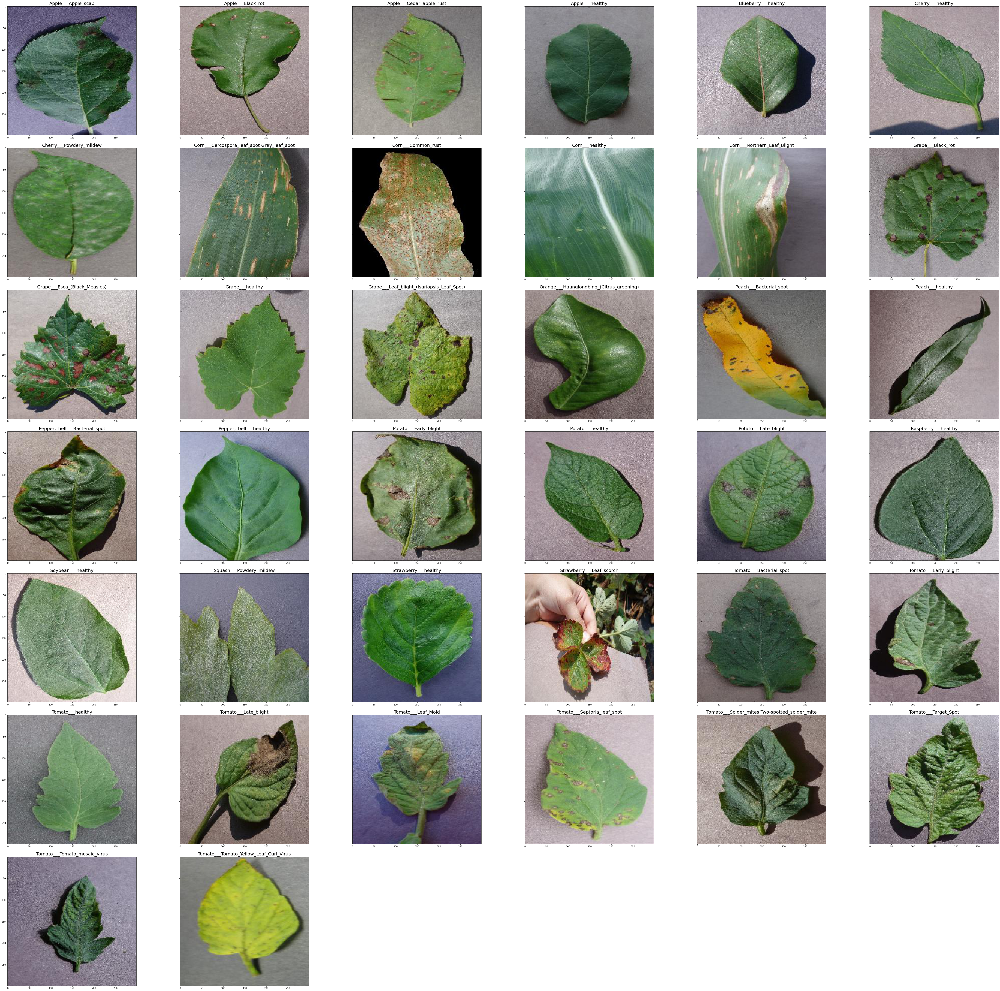

CPU times: user 15.3 s, sys: 321 ms, total: 15.6 s
Wall time: 39.6 s


In [ ]:
# Visualizo una imagen al azar por cada una de las clases del conjunto de imaganes de Train
%%time

test_images_classes = sub_class
test_images=[]

fig, axflat = get_subplot_grid(mylist=test_images_classes, columns=6, figwidth=80, figheight=80)

for idx, label in enumerate(test_images_classes):
    image_folder = os.path.join(train_dir, label)
    image_file = os.path.join(image_folder, random.choice(os.listdir(image_folder)) )
    loaded_image = keras.preprocessing.image.load_img(path=image_file,target_size=(im_width,im_height,channels))
    
    #convert to array and resample dividing by 255
    img_array = keras.preprocessing.image.img_to_array(loaded_image) / 255.
    test_images.append({"idx":idx, "image":img_array, "label": label})
    
    axflat[idx].set_title(label, size=20)
    axflat[idx].imshow(img_array)
plt.show()

In [ ]:
# Incializo los parámetros de batch size y número de épocas para el entrenamiento
# Cuando tenemos imagenes muy grandes necesitamos dividir el proceso de entrenamiento en bloques
# es el numero de imagenes que se entrenarán en cada bloque

batch_size = 32

In [ ]:
# Generacion dataset de train con Data Augmentation

# Es una buena práctica utilizar una división de validación al desarrollar su modelo. 
# Usemos el 80% de las imágenes para entrenamiento y el 20% para validación

# Estandarizar valores para estar en el [0, 1] rango utilizando una capa reescalamiento
train_datagen =  ImageDataGenerator(
    rescale=1/255.0, # con preprocess_input no es necesario hacer el rescalerescale=1/255.0,
    #preprocessing_function=preprocess_input,
    #featurewise_center=False,
    #featurewise_std_normalization=False,
    rotation_range=30,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    #fill_mode="nearest",
    brightness_range=[0.5, 1.5]
    #validation_split=0.20
)

# loads the image dataset in memory and generates batches of augmented data
train_generator = train_datagen.flow_from_directory(
  directory=train_dir,
  target_size=(im_width, im_height),
  batch_size=batch_size,
  color_mode='rgb',
  class_mode='categorical'
  #shuffle=True
  #subset='training',
  #seed=SEED
)

Found 41641 images belonging to 38 classes.


In [ ]:
# Muestro el numero de muestras en training de cada una de las clases

#train_generator.classes contains a list of classes of each image
unique_train, counts_train = np.unique(train_generator.classes, return_counts=True)
print ("number of samples per class in training")
dict(zip(train_generator.class_indices, counts_train))


number of samples per class in training


{'Apple___Apple_scab': 441,
 'Apple___Black_rot': 435,
 'Apple___Cedar_apple_rust': 193,
 'Apple___healthy': 1152,
 'Blueberry___healthy': 1052,
 'Cherry___Powdery_mildew': 737,
 'Cherry___healthy': 598,
 'Corn___Cercospora_leaf_spot Gray_leaf_spot': 360,
 'Corn___Common_rust': 835,
 'Corn___Northern_Leaf_Blight': 690,
 'Corn___healthy': 814,
 'Grape___Black_rot': 826,
 'Grape___Esca_(Black_Measles)': 969,
 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)': 754,
 'Grape___healthy': 297,
 'Orange___Haunglongbing_(Citrus_greening)': 3858,
 'Peach___Bacterial_spot': 1609,
 'Peach___healthy': 252,
 'Pepper,_bell___Bacterial_spot': 698,
 'Pepper,_bell___healthy': 1035,
 'Potato___Early_blight': 700,
 'Potato___Late_blight': 700,
 'Potato___healthy': 107,
 'Raspberry___healthy': 3868,
 'Soybean___healthy': 3564,
 'Squash___Powdery_mildew': 1285,
 'Strawberry___Leaf_scorch': 776,
 'Strawberry___healthy': 320,
 'Tomato___Bacterial_spot': 1490,
 'Tomato___Early_blight': 700,
 'Tomato___Late_blight':

In [ ]:
# Generación dataset de test

# image transformations are performed while training the model
# hace falta pasar algunos parámetros para hacer Data Augmentation?
test_datagen = ImageDataGenerator(
    rescale=1/255.0 # con preprocess_input no es necesario hacer el rescale
)

test_generator = test_datagen.flow_from_directory(
  directory=test_dir,
  target_size=(im_width, im_height),
  batch_size=batch_size,
  color_mode='rgb',
  class_mode='categorical'
  #shuffle=False
)

Found 10856 images belonging to 38 classes.


In [ ]:
# Muestro el numero de muestras en test de cada una de las clases

unique_test, counts_test = np.unique(test_generator.classes, return_counts=True)
print ("number of samples per class in test")
dict(zip(test_generator.class_indices, counts_test))

number of samples per class in test


{'Apple___Apple_scab': 126,
 'Apple___Black_rot': 124,
 'Apple___Cedar_apple_rust': 55,
 'Apple___healthy': 329,
 'Blueberry___healthy': 300,
 'Cherry___Powdery_mildew': 210,
 'Cherry___healthy': 171,
 'Corn___Cercospora_leaf_spot Gray_leaf_spot': 102,
 'Corn___Common_rust': 238,
 'Corn___Northern_Leaf_Blight': 197,
 'Corn___healthy': 232,
 'Grape___Black_rot': 236,
 'Grape___Esca_(Black_Measles)': 276,
 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)': 215,
 'Grape___healthy': 84,
 'Orange___Haunglongbing_(Citrus_greening)': 1100,
 'Peach___Bacterial_spot': 459,
 'Peach___healthy': 72,
 'Pepper,_bell___Bacterial_spot': 200,
 'Pepper,_bell___healthy': 296,
 'Potato___Early_blight': 200,
 'Potato___Late_blight': 200,
 'Potato___healthy': 30,
 'Raspberry___healthy': 74,
 'Soybean___healthy': 1018,
 'Squash___Powdery_mildew': 367,
 'Strawberry___Leaf_scorch': 222,
 'Strawberry___healthy': 91,
 'Tomato___Bacterial_spot': 425,
 'Tomato___Early_blight': 200,
 'Tomato___Late_blight': 383,
 'Tomat

In [ ]:
# Generación dataset de validation

val_datagen = ImageDataGenerator(
    rescale=1/255.0 # con preprocess_input no es necesario hacer el rescale
)

val_generator = val_datagen.flow_from_directory(
  directory=val_dir,
  target_size=(im_width, im_height),
  batch_size=batch_size,
  color_mode='rgb',
  class_mode='categorical'
  #shuffle=False
)

Found 5418 images belonging to 38 classes.


In [ ]:
unique_val, counts_val = np.unique(val_generator.classes, return_counts=True)
print ("number of samples per class in test")
dict(zip(val_generator.class_indices, counts_val))

number of samples per class in test


{'Apple___Apple_scab': 63,
 'Apple___Black_rot': 62,
 'Apple___Cedar_apple_rust': 27,
 'Apple___healthy': 164,
 'Blueberry___healthy': 150,
 'Cherry___Powdery_mildew': 105,
 'Cherry___healthy': 85,
 'Corn___Cercospora_leaf_spot Gray_leaf_spot': 51,
 'Corn___Common_rust': 119,
 'Corn___Northern_Leaf_Blight': 98,
 'Corn___healthy': 116,
 'Grape___Black_rot': 118,
 'Grape___Esca_(Black_Measles)': 138,
 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)': 107,
 'Grape___healthy': 42,
 'Orange___Haunglongbing_(Citrus_greening)': 550,
 'Peach___Bacterial_spot': 229,
 'Peach___healthy': 36,
 'Pepper,_bell___Bacterial_spot': 99,
 'Pepper,_bell___healthy': 147,
 'Potato___Early_blight': 100,
 'Potato___Late_blight': 100,
 'Potato___healthy': 15,
 'Raspberry___healthy': 37,
 'Soybean___healthy': 509,
 'Squash___Powdery_mildew': 183,
 'Strawberry___Leaf_scorch': 111,
 'Strawberry___healthy': 45,
 'Tomato___Bacterial_spot': 212,
 'Tomato___Early_blight': 100,
 'Tomato___Late_blight': 191,
 'Tomato___Leaf

In [ ]:
print ("Porcentaje por class en Train")
dict(zip(train_generator.class_indices, counts_train / (counts_train + counts_test + counts_val)))

Porcentaje por class en Train


{'Apple___Apple_scab': 0.7,
 'Apple___Black_rot': 0.7004830917874396,
 'Apple___Cedar_apple_rust': 0.7018181818181818,
 'Apple___healthy': 0.7003039513677811,
 'Blueberry___healthy': 0.7003994673768309,
 'Cherry___Powdery_mildew': 0.7005703422053232,
 'Cherry___healthy': 0.7002341920374707,
 'Corn___Cercospora_leaf_spot Gray_leaf_spot': 0.7017543859649122,
 'Corn___Common_rust': 0.700503355704698,
 'Corn___Northern_Leaf_Blight': 0.700507614213198,
 'Corn___healthy': 0.7005163511187608,
 'Grape___Black_rot': 0.7,
 'Grape___Esca_(Black_Measles)': 0.7006507592190889,
 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)': 0.7007434944237918,
 'Grape___healthy': 0.7021276595744681,
 'Orange___Haunglongbing_(Citrus_greening)': 0.7004357298474946,
 'Peach___Bacterial_spot': 0.7004788855028298,
 'Peach___healthy': 0.7,
 'Pepper,_bell___Bacterial_spot': 0.7001003009027081,
 'Pepper,_bell___healthy': 0.7002706359945873,
 'Potato___Early_blight': 0.7,
 'Potato___Late_blight': 0.7,
 'Potato___healthy': 0.

In [ ]:
print ("Porcentaje por class en Test")
dict(zip(test_generator.class_indices, counts_test / (counts_train + counts_test + counts_val)))

Porcentaje por class en Test


{'Apple___Apple_scab': 0.2,
 'Apple___Black_rot': 0.1996779388083736,
 'Apple___Cedar_apple_rust': 0.2,
 'Apple___healthy': 0.2,
 'Blueberry___healthy': 0.19973368841544606,
 'Cherry___Powdery_mildew': 0.19961977186311788,
 'Cherry___healthy': 0.20023419203747073,
 'Corn___Cercospora_leaf_spot Gray_leaf_spot': 0.19883040935672514,
 'Corn___Common_rust': 0.19966442953020133,
 'Corn___Northern_Leaf_Blight': 0.2,
 'Corn___healthy': 0.19965576592082615,
 'Grape___Black_rot': 0.2,
 'Grape___Esca_(Black_Measles)': 0.19956616052060738,
 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)': 0.19981412639405205,
 'Grape___healthy': 0.19858156028368795,
 'Orange___Haunglongbing_(Citrus_greening)': 0.19970951343500362,
 'Peach___Bacterial_spot': 0.1998258598171528,
 'Peach___healthy': 0.2,
 'Pepper,_bell___Bacterial_spot': 0.20060180541624875,
 'Pepper,_bell___healthy': 0.20027063599458728,
 'Potato___Early_blight': 0.2,
 'Potato___Late_blight': 0.2,
 'Potato___healthy': 0.19736842105263158,
 'Raspberry_

In [ ]:
print ("Porcentaje por class en Validation")
dict(zip(val_generator.class_indices, counts_val / (counts_train + counts_test + counts_val + counts_val)))

Porcentaje por class en Validation


{'Apple___Apple_scab': 0.09090909090909091,
 'Apple___Black_rot': 0.09077598828696926,
 'Apple___Cedar_apple_rust': 0.08940397350993377,
 'Apple___healthy': 0.09065782200110559,
 'Blueberry___healthy': 0.09079903147699758,
 'Cherry___Powdery_mildew': 0.09075194468452895,
 'Cherry___healthy': 0.09052183173588925,
 'Corn___Cercospora_leaf_spot Gray_leaf_spot': 0.09042553191489362,
 'Corn___Common_rust': 0.09077040427154844,
 'Corn___Northern_Leaf_Blight': 0.0904893813481071,
 'Corn___healthy': 0.09076682316118936,
 'Grape___Black_rot': 0.09090909090909091,
 'Grape___Esca_(Black_Measles)': 0.09072978303747535,
 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)': 0.0904480135249366,
 'Grape___healthy': 0.09032258064516129,
 'Orange___Haunglongbing_(Citrus_greening)': 0.09078903928689336,
 'Peach___Bacterial_spot': 0.09065716547901821,
 'Peach___healthy': 0.09090909090909091,
 'Pepper,_bell___Bacterial_spot': 0.09032846715328467,
 'Pepper,_bell___healthy': 0.09046153846153847,
 'Potato___Early_bl

Batch shape (input):  (32, 299, 299, 3)
Batch shape (target): (32, 38)


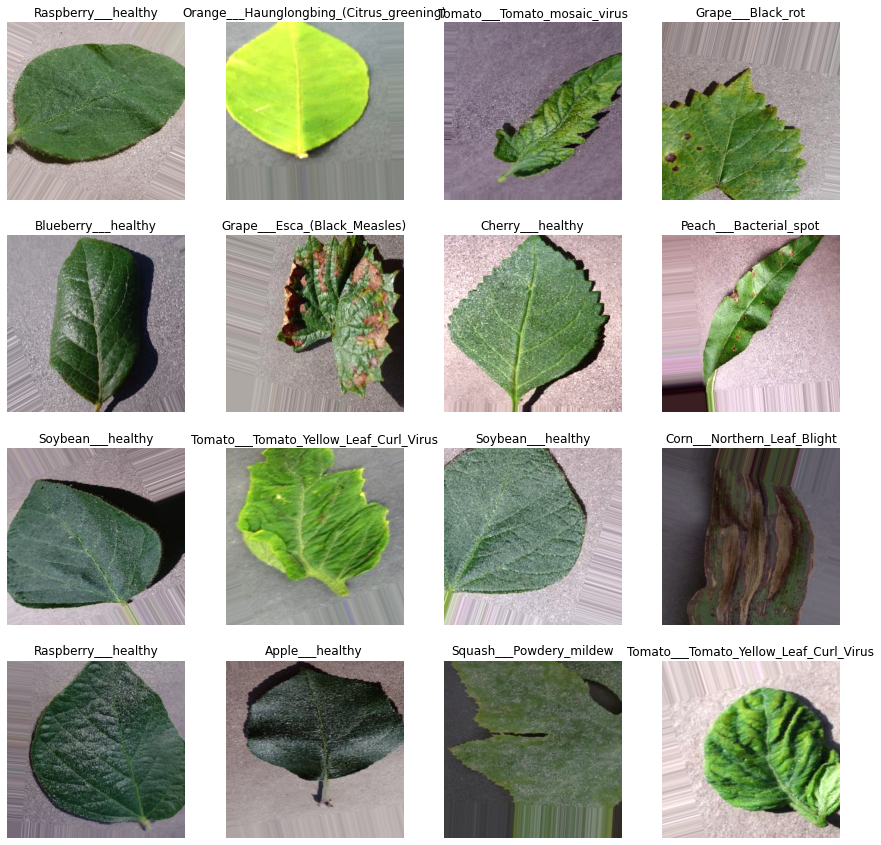

CPU times: user 1.87 s, sys: 65.9 ms, total: 1.94 s
Wall time: 17.6 s


In [ ]:
# Pintar alguno de los datos que estoy tratando aplicando Data Augmentation
%%time 

classes = [k for k, v in train_generator.class_indices.items()]

n_rows = 4
n_cols = 4

for batch_x, batch_y in train_generator:
    print("Batch shape (input): ", batch_x.shape)
    print("Batch shape (target):", batch_y.shape)

    plt.figure(figsize=(15, 15))
    for c, x, y in zip(range(len(batch_x)), batch_x, batch_y):
        if c == n_rows * n_cols:
            break

        plt.subplot(n_rows, n_cols, c + 1)
        plt.imshow(x)
        plt.axis("off")
        plt.title(classes[np.where(y)[0][0]])

    plt.show()
    break

In [ ]:
# Setup base model:

# transfer learning: inceptionv3
# lower layers: general features
# high layer: specific features
# A frozen layer does not change during training

# Strategies:
# 1. Train entire model
# 2. Train some layers and leave the others frozen (careful with learning rate)
# 3. Freeze the convolutional base (careful with learning rate) > small dataset and similar to the pre-trained model's dataset

# 1. Obtain the pre-trained model: instantiate the base model
# 2. Create a base model: replace the last layer and add a final output layer that is compatible with my problem
# 3. Freeze layer: i don't want the weights in those layers to be re-initialized
# 4. Train the new layers on the dataset: measure classification accuracy. Add new trainable layers, pre-trained 
#   model is loaded without the final output layer
# 5. Improve the model via fine-tuning: unfreezing the base model or part of it trainining the entire model again at a very low learning rate
#   The low learning rate will increase the performance of the model on the new dataset while preventing overfitting.
#   Recompile the model once.
#   Train the model again while monitoring it via callbacks to ensure it does not overfit

# Imports the mobilenet model and discards the last 1000 neuron layer.
# include_top=False excludes final FC layer

base_model = inception_v3.InceptionV3(weights='imagenet', include_top=False)

#print(base_model.summary())

87924736/87910968 [==============================] - 2s 0us/step


In [ ]:
# Add new last layer

# add last layer to the convonlutional network
#fc_size=1024

x = base_model.output

# converts features from the base model to vectors
x = GlobalAveragePooling2D()(x)
x = Dense(1024,activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.4)(x) 

#dense layer 2
x = Dense(512,activation='relu')(x)
x = BatchNormalization()(x)

#dense layer 3
x = Dense(256,activation='relu')(x) 

# esta es nueva
x = Dense(128,activation='relu')(x) 

#final layer with softmax activation
preds = Dense(n_classes,activation='softmax')(x) 

# a model has been created based on our architecture
model = Model(inputs=base_model.input,outputs=preds)

In [ ]:
# Setup to transfer learn

# freeze all convolutional InceptionV3 layers and compile the model
for layer in base_model.layers:
    layer.trainable = False


In [ ]:
print(model.summary())


Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv2d (Conv2D)                (None, None, None,   864         ['input_1[0][0]']                
                                32)                                                               
                                                                                                  
 batch_normalization (BatchNorm  (None, None, None,   96         ['conv2d[0][0]']                 
 alization)                     32)                                                           

In [ ]:
for i, layer in enumerate(model.layers):
   print(i, layer.name, layer.trainable)

0 input_1 False
1 conv2d False
2 batch_normalization False
3 activation False
4 conv2d_1 False
5 batch_normalization_1 False
6 activation_1 False
7 conv2d_2 False
8 batch_normalization_2 False
9 activation_2 False
10 max_pooling2d False
11 conv2d_3 False
12 batch_normalization_3 False
13 activation_3 False
14 conv2d_4 False
15 batch_normalization_4 False
16 activation_4 False
17 max_pooling2d_1 False
18 conv2d_8 False
19 batch_normalization_8 False
20 activation_8 False
21 conv2d_6 False
22 conv2d_9 False
23 batch_normalization_6 False
24 batch_normalization_9 False
25 activation_6 False
26 activation_9 False
27 average_pooling2d False
28 conv2d_5 False
29 conv2d_7 False
30 conv2d_10 False
31 conv2d_11 False
32 batch_normalization_5 False
33 batch_normalization_7 False
34 batch_normalization_10 False
35 batch_normalization_11 False
36 activation_5 False
37 activation_7 False
38 activation_10 False
39 activation_11 False
40 mixed0 False
41 conv2d_15 False
42 batch_normalization_15 False

In [ ]:
keras.utils.plot_model(model, show_shapes=True)

In [ ]:
# se puede probar con otro optimizador como "rmsprop"

# también puedo probar con otros optimizadores
#adam = Adam(learning_rate=0.00001)
#model.compile(optimizer=adam, loss='categorical_crossentropy', metrics=['accuracy'])

# El learning rate es uno de los parámetros más importantes que hay que configurar, 
# con un valor muy pequeña la red no aprenderá y con un valor muy alto puede que tengamos overfitting. 
# Es útil reducir la tasa de aprendizaje a medida que avanza el entrenamiento, 
# con el ExponentialDecay lo que hago es aplicar una función de disminución exponencial 
# a un paso del optimizador dada una tasa de aprendizaje inicial, en mi caso lo he configurado cada 10000 pasos

lr_schedule = keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=0.001,
    decay_steps=10000,
    decay_rate=0.80,
    staircase=True)

opt = keras.optimizers.Adam(learning_rate=lr_schedule)

model.compile(
    loss="categorical_crossentropy",
    optimizer=opt,
    metrics=["accuracy"]
)

In [ ]:
# Mediante EarlyStopping tengo una función de parada para el entrenamiento del modelo 
#de manera que si durante el entrenamiento del modelo el error de validación no mejora paro, en este caso si en 3 pasos

# Mediante ModelCheckpoint voy guardando el modelo final a medida que pasa cada época, 
# se permite ir guardando sobre la marcha el modelo, está pensado para entrenamientos muy largos. 
# Con la opción save_best_only lo que le digo es que solo me guarde el modelo si es mejor.

early_stopping = keras.callbacks.EarlyStopping(patience=3, mode='auto')
checkpoint = keras.callbacks.ModelCheckpoint(model_saved_dir, save_best_only=True)

In [ ]:
# Se define el tamaño de cada paso en train y en validation como el número total de elementos de train 
# y validation dividido por el tamaño de batch size que he definido inicialmente

epochs = 8
batch_size = 32

step_size_train = train_generator.n//train_generator.batch_size
step_size_test = test_generator.n//test_generator.batch_size
step_size_val = val_generator.n//val_generator.batch_size

In [ ]:
# Transfer learning
%%time

#history_tl = model.fit_generator(
  # training data
#  generator=train_generator, 
#  steps_per_epoch=step_size_train,
  # validation data
#  validation_data=test_generator,
#  validation_steps=step_size_test,
#  epochs=epochs
#)

history_tl = model.fit(
    train_generator,
    validation_data=val_generator,
    epochs=epochs,
    steps_per_epoch=step_size_train,
    batch_size=batch_size,
    validation_steps=step_size_val, 
    #validation_split = 0.1,
    callbacks=[early_stopping, checkpoint]
)

Epoch 1/8
1301/1301 [==============================] - 23361s 18s/step - loss: 0.8113 - accuracy: 0.7105 - val_loss: 0.5117 - val_accuracy: 0.8432
Epoch 2/8
1301/1301 [==============================] - 967s 743ms/step - loss: 0.5541 - accuracy: 0.7781 - val_loss: 0.5560 - val_accuracy: 0.7949
Epoch 3/8
1301/1301 [==============================] - 987s 758ms/step - loss: 0.5026 - accuracy: 0.7924 - val_loss: 0.4154 - val_accuracy: 0.8580
Epoch 4/8
1301/1301 [==============================] - 995s 765ms/step - loss: 0.4692 - accuracy: 0.8047 - val_loss: 0.3722 - val_accuracy: 0.8232
Epoch 5/8
1301/1301 [==============================] - 1000s 769ms/step - loss: 0.4516 - accuracy: 0.8088 - val_loss: 0.3368 - val_accuracy: 0.8670
Epoch 6/8
1301/1301 [==============================] - 972s 747ms/step - loss: 0.4364 - accuracy: 0.8123 - val_loss: 0.3829 - val_accuracy: 0.8149
Epoch 7/8
1301/1301 [==============================] - 992s 763ms/step - loss: 0.4253 - accuracy: 0.8195 - val_loss: 

In [ ]:
%%time
[loss, acc] = model.evaluate(test_generator, verbose=0)
print("Test accuracy: %.2f%%" % (100 * acc))
print("Test loss:", loss)

Test accuracy: 86.67%
Test loss: 0.2751620411872864
CPU times: user 1min 1s, sys: 6.53 s, total: 1min 8s
Wall time: 1h 28min 13s


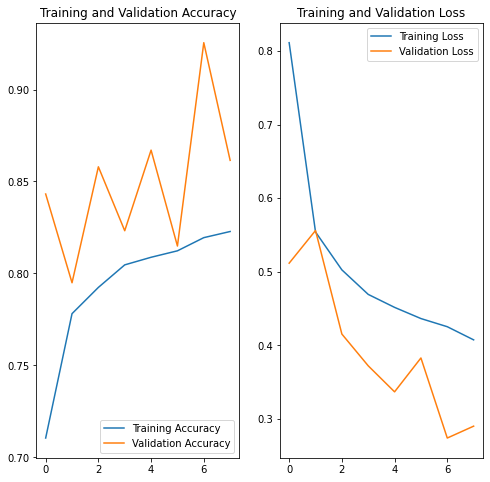

In [ ]:
acc = history_tl.history['accuracy']
val_acc = history_tl.history['val_accuracy']

loss = history_tl.history['loss']
val_loss = history_tl.history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

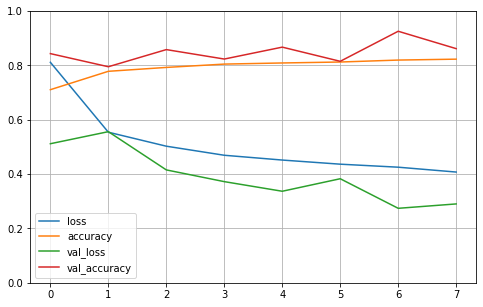

In [ ]:
pd.DataFrame(history_tl.history).plot(figsize=(8,5))
plt.grid(True)
plt.gca().set_ylim(0, 1)
plt.show()

In [ ]:
# Setup to fine tunning

# Freeze the bottom NB_IV3_LAYERS and retrain the remaining top layers
# NB_IV3_LAYERS correspondns to the top 2 inception blocks in the inceptionv3 architecture
# Es importante congelar la base convolucional antes de compilar y entrenar el modelo
# La congelación evita que los pesos de una capa determinada se actualicen durante el entrenamiento

# we will freeze the first 249 (o 172) layers and unfreeze the rest 
layers_to_freeze = 171

for layer in model.layers[:layers_to_freeze]:
    layer.trainable=False
for layer in model.layers[layers_to_freeze:]:
    layer.trainable=True

# Se puede probar otro optimizador como "SGD(lr=0.0001, momentum=0.9)"
#optimizer = k.optimizers.Adam(lr=0.001, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False)
#optimizer = k.optimizers.Adamax(lr=0.002, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0)
#optimizer = k.optimizers.Nadam(lr=0.002, beta_1=0.9, beta_2=0.999, epsilon=None, schedule_decay=0.004)

#adam = Adam(learning_rate=0.00001)
#model.compile(optimizer=adam, 
#              loss='categorical_crossentropy', 
#              metrics=['accuracy'])

In [ ]:
for i, layer in enumerate(model.layers):
   print(i, layer.name, layer.trainable)

0 input_1 False
1 conv2d False
2 batch_normalization False
3 activation False
4 conv2d_1 False
5 batch_normalization_1 False
6 activation_1 False
7 conv2d_2 False
8 batch_normalization_2 False
9 activation_2 False
10 max_pooling2d False
11 conv2d_3 False
12 batch_normalization_3 False
13 activation_3 False
14 conv2d_4 False
15 batch_normalization_4 False
16 activation_4 False
17 max_pooling2d_1 False
18 conv2d_8 False
19 batch_normalization_8 False
20 activation_8 False
21 conv2d_6 False
22 conv2d_9 False
23 batch_normalization_6 False
24 batch_normalization_9 False
25 activation_6 False
26 activation_9 False
27 average_pooling2d False
28 conv2d_5 False
29 conv2d_7 False
30 conv2d_10 False
31 conv2d_11 False
32 batch_normalization_5 False
33 batch_normalization_7 False
34 batch_normalization_10 False
35 batch_normalization_11 False
36 activation_5 False
37 activation_7 False
38 activation_10 False
39 activation_11 False
40 mixed0 False
41 conv2d_15 False
42 batch_normalization_15 False

In [ ]:
print(model.summary())

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv2d (Conv2D)                (None, None, None,   864         ['input_1[0][0]']                
                                32)                                                               
                                                                                                  
 batch_normalization (BatchNorm  (None, None, None,   96         ['conv2d[0][0]']                 
 alization)                     32)                                                           

In [ ]:
lr_schedule = keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=0.001,
    decay_steps=10000,
    decay_rate=0.80,
    staircase=True)

opt = keras.optimizers.Adam(learning_rate=lr_schedule)

model.compile(
    loss="categorical_crossentropy",
    optimizer=opt,
    metrics=["accuracy"]
)

In [ ]:
# Configuración de los callbacks para el finetune

# EarlyStopping, para que el entrenamiento pare si ve que no mejora la función de coste tras determinados epochs
# ReduceLROnPlateau, que si el entrenamiento no mejora tras unos epochs específicos, reduce el valor de learning rate del modelo, 
# lo que normalmente obtiene una mejora del entrenamiento

#tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)
#early_stop = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=8, verbose=1, min_delta=1e-4)  
#reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=4, verbose=1, min_delta=1e-4)  
#model_cp = tf.keras.callbacks.ModelCheckpoint("trained_model_inceptionV3.h5", monitor='val_loss', save_best_only = True),

# solo incluyo los necesarios para TensorBoard y ModelCheckpoint
#callbacks_list = [tensorboard_callback, early_stop] 

In [ ]:
early_stopping = keras.callbacks.EarlyStopping(patience=3, mode='auto')
checkpoint = keras.callbacks.ModelCheckpoint(model_saved_dir, save_best_only=True)

In [ ]:
epochs = 8
batch_size = 32

step_size_train = train_generator.n//train_generator.batch_size
step_size_test = test_generator.n//test_generator.batch_size
step_size_val = val_generator.n//val_generator.batch_size

In [ ]:
# Fitting/Training the final model
%%time

#history_ft = model.fit_generator(
  # training data
#  generator=train_generator, 
#  steps_per_epoch=step_size_train,
  # validation data
#  validation_data=test_generator,
#  validation_steps=step_size_test,
#  epochs=epochs
  #callbacks=[callbacks_list]
#)

history_tl = model.fit(
    train_generator,
    validation_data=val_generator,
    epochs=epochs,
    steps_per_epoch=step_size_train,
    batch_size=batch_size,
    validation_steps=step_size_val, 
    #validation_split = 0.1,
    callbacks=[early_stopping, checkpoint]
)

Epoch 1/8
1301/1301 [==============================] - 1011s 771ms/step - loss: 0.4595 - accuracy: 0.8136 - val_loss: 0.2511 - val_accuracy: 0.8578
Epoch 2/8
1301/1301 [==============================] - 1002s 770ms/step - loss: 0.2837 - accuracy: 0.8646 - val_loss: 0.1416 - val_accuracy: 0.9682
Epoch 3/8
1301/1301 [==============================] - 1007s 774ms/step - loss: 0.2442 - accuracy: 0.8749 - val_loss: 0.1374 - val_accuracy: 0.9732
Epoch 4/8
1301/1301 [==============================] - 983s 755ms/step - loss: 0.2385 - accuracy: 0.8774 - val_loss: 0.1669 - val_accuracy: 0.8842
Epoch 5/8
1301/1301 [==============================] - 977s 751ms/step - loss: 0.2138 - accuracy: 0.8850 - val_loss: 0.2588 - val_accuracy: 0.9366
Epoch 6/8
1301/1301 [==============================] - 1005s 772ms/step - loss: 0.2078 - accuracy: 0.8875 - val_loss: 0.1173 - val_accuracy: 0.9780
Epoch 7/8
1301/1301 [==============================] - 980s 753ms/step - loss: 0.1968 - accuracy: 0.8908 - val_los

In [ ]:
%%time
[loss, acc] = model.evaluate(test_generator, verbose=0)
print("Test accuracy: %.2f%%" % (100 * acc))
print("Test loss:", loss)

Test accuracy: 89.37%
Test loss: 0.12724296748638153
CPU times: user 41.9 s, sys: 3.71 s, total: 45.6 s
Wall time: 41.5 s


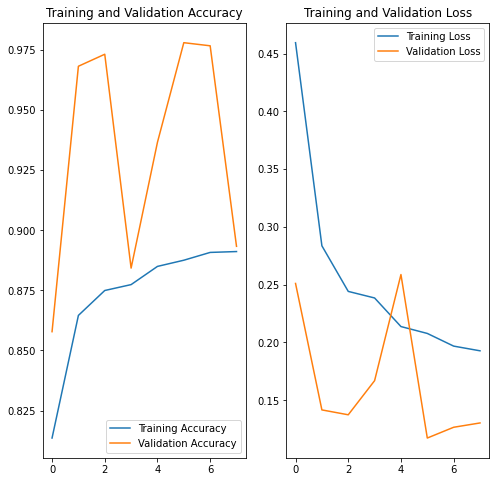

In [ ]:
acc = history_tl.history['accuracy']
val_acc = history_tl.history['val_accuracy']

loss = history_tl.history['loss']
val_loss = history_tl.history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

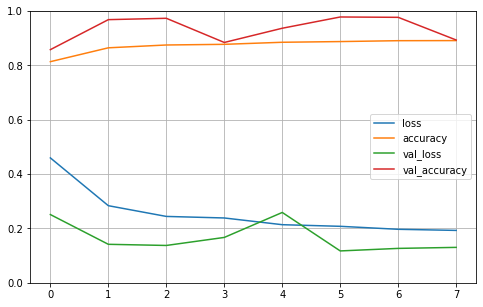

In [ ]:
pd.DataFrame(history_tl.history).plot(figsize=(8,5))
plt.grid(True)
plt.gca().set_ylim(0, 1)
plt.show()

In [ ]:
# save model inceptionV3

#%%time

# (1) .h5: To save and load the weights of the model, you would first use
# (2) model.save(filepath): 
#    - The architecture of the model, allowing to re-create the model.
#    - The weights of the model.
#    - The training configuration (loss, optimizer).
#    - The state of the optimizer, allowing to resume training exactly where you left off.
# (3) model.to_json(): saves only the architecture of the model

#model.save('/content/gdrive/MyDrive/tfm/models/inceptionV3/v2-01-InceptionV3-model.h5')

#model.save(model_saved_dir)

**PREDICCION**

In [ ]:
# Import libraries

import numpy as np
import os
from keras.preprocessing import image
from keras import preprocessing
from keras.models import load_model

# Librerias para visualizar las imágenes
%matplotlib inline
import matplotlib.pyplot as plt


In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

model_saved_dir = '/content/gdrive/MyDrive/tfm/models/inceptionV3-2/v2-01-InceptionV3-2-model'

train_dir = '/content/gdrive/MyDrive/tfm/version2/train_dir/'
test_dir = '/content/gdrive/MyDrive/tfm/version2/test_dir/'
val_dir = '/content/gdrive/MyDrive/tfm/version2/val_dir/'

Mounted at /content/gdrive


In [ ]:
%%time

history_ft = load_model(model_saved_dir)

CPU times: user 11.8 s, sys: 1.32 s, total: 13.1 s
Wall time: 19.1 s


{'Apple___Apple_scab': '0.00%', 'Apple___Black_rot': '99.97%', 'Apple___Cedar_apple_rust': '0.03%', 'Apple___healthy': '0.00%', 'Blueberry___healthy': '0.00%', 'Cherry___healthy': '0.00%', 'Cherry___Powdery_mildew': '0.00%', 'Corn___Cercospora_leaf_spot Gray_leaf_spot': '0.00%', 'Corn___Common_rust': '0.00%', 'Corn___healthy': '0.00%', 'Corn___Northern_Leaf_Blight': '0.00%', 'Grape___Black_rot': '0.00%', 'Grape___Esca_(Black_Measles)': '0.00%', 'Grape___healthy': '0.00%', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)': '0.00%', 'Orange___Haunglongbing_(Citrus_greening)': '0.00%', 'Peach___Bacterial_spot': '0.00%', 'Peach___healthy': '0.00%', 'Pepper,_bell___Bacterial_spot': '0.00%', 'Pepper,_bell___healthy': '0.00%', 'Potato___Early_blight': '0.00%', 'Potato___healthy': '0.00%', 'Potato___Late_blight': '0.00%', 'Raspberry___healthy': '0.00%', 'Soybean___healthy': '0.00%', 'Squash___Powdery_mildew': '0.00%', 'Strawberry___healthy': '0.00%', 'Strawberry___Leaf_scorch': '0.00%', 'Tomato___B

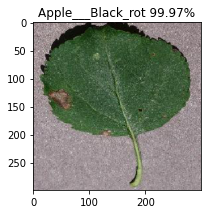

CPU times: user 230 ms, sys: 7.57 ms, total: 238 ms
Wall time: 1.24 s


<Figure size 432x288 with 0 Axes>

In [ ]:
%%time

im_width = 299
im_height = 299
channels=3

trained_classes_labels = os.listdir(train_dir)

img_path = "/content/gdrive/MyDrive/tfm/version2/test_dir/Apple___Black_rot/image (1).JPG"
#img_path = "/content/gdrive/MyDrive/images-google/grape-4.jpg"

loaded_image = preprocessing.image.load_img(
        path=img_path,
        target_size=(im_width,im_height,channels))

img_array = preprocessing.image.img_to_array(loaded_image) / 255.

img_np_array = np.expand_dims(img_array, axis = 0)

predictions = history_ft.predict(img_np_array)
classidx = np.argmax(predictions[0])
label = trained_classes_labels[classidx]

predictions_pct = ["{:.2f}%".format(prob * 100) for prob in predictions[0] ]
print(dict(zip(trained_classes_labels, predictions_pct)) )
print("Prediction: %s (class %s) %s" % (label, classidx, predictions_pct[classidx])) 

plt.figure(figsize=(3,4))
plt.imshow(img_array)
plt.title("%s %s" % (label, predictions_pct[classidx]))
plt.show()

plt.gcf().clear()